In [6]:
import networkx as nx
from scipy.stats import norm
import cv2
from src.process import contour
from src.methods.aorta_contour import by_point
import plotly.express as px

def outer_wall(image, aorta, expand_coef=1, width=10):
    def expand(aorta, alpha):
        ksize = 15
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (ksize, ksize))
        aorta = cv2.erode(aorta.astype("uint8"), kernel)
        aorta = cv2.dilate(aorta, kernel)

        contours, _ = cv2.findContours(aorta.astype("uint8"), cv2.RETR_TREE, 1)
        aorta_contour = contours[0]
        area = contour.area(aorta_contour)
        ksize = int(alpha * area ** 0.5)
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (ksize, ksize))
        return cv2.dilate(aorta.astype('uint8'), kernel).astype('bool')

        contours, _ = cv2.findContours(aorta.astype("uint8"), cv2.RETR_TREE, 1)
        aorta_contour = contours[0]
        area = contour.area(aorta_contour)

        ksize = int(alpha * area ** 0.5)
        kernel = np.ones((ksize, ksize), 'uint8')
        return cv2.dilate(aorta.astype('uint8'), kernel).astype('bool')
        
    def gcpdf(image, aorta, initial):
        def get_norm_dist_pdf(mean, var):
            std = var ** 0.5
            def pdf(x):
                return norm.pdf((x - mean) / std) / std
            return pdf

        outer_init = initial.copy()
        outer_init[aorta] = False
        mean = image[outer_init].mean()
        var = image[outer_init].var()
        pdf = get_norm_dist_pdf(mean, var)
        g = nx.Graph()
        g.add_node('s')
        g.add_node('t')
        source_weights = []
        source_min, source_max = float('inf'), float('-inf')
        edge_weights = []
        edge_min, edge_max = float('inf'), float('-inf')
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if outer_init[i][j]:
                    g.add_node((i, j))
                    dens = pdf(image[i][j])
                    source_weights.append([(i,j), dens])
                    source_min = source_min if source_min < dens else dens
                    source_max = source_max if source_max > dens else dens
                    local_var = float(np.array([[image[i-1][j-1],image[i-1][j],image[i-1][j+1]],
                                          [image[i+0][j-1],image[i+0][j],image[i+0][j+1]],
                                          [image[i+1][j-1],image[i+1][j],image[i+1][j+1]]]).var())
                    edge_min = edge_min if edge_min < local_var else local_var
                    edge_max = edge_max if edge_max > local_var else local_var
                    if outer_init[i+1][j]:
                        edge_weights.append([(i,j), (i+1,j), local_var])
                    if outer_init[i][j+1]:
                        edge_weights.append([(i,j), (i,j+1), local_var])

        source_coef = 100 / (source_max - source_min)
        edge_coef = 100 / (edge_max - edge_min)
                    
        for i in range(len(source_weights)):
            source_weights[i][1] = source_coef * (source_weights[i][1] - source_min)
        for i in range(len(edge_weights)):
            edge_weights[i][2] = edge_coef * (edge_max - edge_weights[i][2])

        m = source_weights[0][1]
        for l in source_weights:
            m = m if m > l[1] else l[1]
        
        g.add_weighted_edges_from([(l[0], 's', l[1]) for l in source_weights])
        g.add_weighted_edges_from([(l[0], 't', 100-l[1]) for l in source_weights])
        g.add_weighted_edges_from(edge_weights)

        _, partition = nx.minimum_cut(g, 's', 't', capacity='weight')
        reachable, unreachable = partition

        unreachable.remove('t')
        reachable.remove('s')
        reach = np.zeros_like(image, dtype='bool')
        for point in reachable:
            reach[point[0], point[1]] = True
        unreach = np.zeros_like(image, dtype='bool')
        for point in unreachable:
            unreach[point[0], point[1]] = True

        return outer_init

    def gcbac(image, initial, width=10):
        current = initial.copy().astype(np.uint8)

        contours, _ = cv2.findContours(current, cv2.RETR_TREE, 1)
        inner_contour = contours[0]
        inner_contour_image = np.zeros_like(image, dtype='uint8')
        cv2.drawContours(inner_contour_image, [inner_contour], -1, 1, width,)

        contours, _ = cv2.findContours(inner_contour_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
        contours.sort(key=len, reverse=True)
        external_contour = contours[0]
        external_contour_image = np.zeros_like(image, dtype='uint8')
        cv2.drawContours(external_contour_image, [external_contour], -1, 1, 1)
        internal_contour = contours[1]
        internal_contour_image = np.zeros_like(image, dtype='uint8')
        cv2.drawContours(internal_contour_image, [internal_contour], -1, 1, 1)

        inner_contour_image = inner_contour_image.astype(np.bool)
        external_contour_image = external_contour_image.astype(np.bool)
        internal_contour_image = internal_contour_image.astype(np.bool)
        inner_contour_image[external_contour_image] = False
        inner_contour_image[internal_contour_image] = False

        g = nx.Graph()
        g.add_node('s')
        g.add_node('t')
        inner_posses = list(zip(*np.where(inner_contour_image==True)))
        g.add_nodes_from(inner_posses)
        external_posses = list(zip(*np.where(external_contour_image)))
        internal_posses = list(zip(*np.where(internal_contour_image)))
        g.add_nodes_from(external_posses)
        g.add_nodes_from(internal_posses)
        g.add_edges_from([(pos, 's') for pos in internal_posses])
        g.add_edges_from([(pos, 't') for pos in external_posses if pos not in internal_posses])

        for i, j in inner_posses:
            g.add_edge((i, j), (i, j+1), capacity=abs(image[i, j] - image[i, j+1]))
            g.add_edge((i, j), (i, j-1), capacity=abs(image[i, j] - image[i, j-1]))
            g.add_edge((i, j), (i+1, j), capacity=abs(image[i, j] - image[i+1, j]))
            g.add_edge((i, j), (i-1, j), capacity=abs(image[i, j] - image[i-1, j]))    

        _, partition = nx.minimum_cut(g, 's', 't', capacity='capacity')
        reachable, unreachable = partition
        reachable.remove('s')
        unreachable.remove('t')

        reachable_canvas = np.zeros_like(image)
        unreachable_canvas = np.zeros_like(image)
        x, y = zip(*reachable)
        reachable_canvas[x, y] = True
        contours, _ = cv2.findContours(reachable_canvas.astype("uint8"), cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

        contour = contours[0]
        for cont in contours:
            contour = contour if len(contour) >= len(cont) else cont

        result = np.zeros_like(image, dtype=np.uint8)
        cv2.fillConvexPoly(result, contour, 1, 1)
        
        return result.astype('bool')

    
    tuned = None
    current = expand(aorta.copy(), expand_coef)
    for i in range(20):
        segmented = gcpdf(image, aorta, current)
        tuned = gcbac(image, segmented, width)
        current = tuned
    return tuned

In [1]:
from pathlib import Path
import imageio

def get_picture(pic):
    picture = imageio.imread(Path("unmarked") / pic)
    return picture

def get_center(pic):
    x, y = Path("marks", "centers", str(pic)+".center").open().read().split(", ")
    x, y = int(x), int(y)
    return (x, y)

def get_mask(pic):
    f = Path("marks", "masks", str(pic)+".binary")
    return imageio.imread(f).astype("bool")

def imageWithContour(picture, contour_image):
    canvas = picture.copy()
    contours, _ = cv2.findContours(contour_image.astype("uint8"), 1, 1)
    cv2.drawContours(canvas, contours, -1, int(picture.max()))
    return canvas

dataset = [Path(*f.parts[-2:]) for f in Path("unmarked").glob("**/*.png") if f.parts[-2] != "02" and f.parts[-2] != "01"]
del dataset[-2]

In [143]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

pic = dataset[7]
picture = get_picture(pic)
# picture = cv2.GaussianBlur(picture, (5,5), 0)
aorta = by_point(picture, get_center(pic))

In [144]:
def expand(aorta, alpha):

    ksize = 15
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (ksize, ksize))
    aorta = cv2.erode(aorta.astype("uint8"), kernel)
    aorta1 = aorta.copy().astype("bool")
    aorta = cv2.dilate(aorta, kernel)
    aorta2 = aorta.copy().astype("bool")

    contours, _ = cv2.findContours(aorta.astype("uint8"), cv2.RETR_TREE, 1)
    aorta_contour = contours[0]
    area = contour.area(aorta_contour)
    ksize = int(alpha * area ** 0.5)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (ksize, ksize))
    return cv2.dilate(aorta.astype('uint8'), kernel).astype('bool')

expanded = expand(aorta, 1.5)

canvas = picture.copy()
expanded_contour, _ = cv2.findContours(expanded.astype("uint8"), 1,1)
cv2.drawContours(canvas, expanded_contour, -1, 500)
px.imshow(canvas)

In [126]:
def gcpdf(image, aorta, initial):
        def get_norm_dist_pdf(mean, std):
            def pdf(x):
                return norm.pdf(x, mean, std)
            return pdf

        outer_init = initial.copy()
        outer_init[aorta] = False
        mean = image[outer_init].mean()
        std = image[outer_init].std()
        print(sum(sum(outer_init)))
        print(sum(image[outer_init]))
        print(mean, std)
        pdf = get_norm_dist_pdf(mean, std)
        g = nx.Graph()
        g.add_node('s')
        g.add_node('t')
        source_weights = []
        source_min, source_max = float('inf'), float('-inf')
        edge_weights = []
        edge_min, edge_max = float('inf'), float('-inf')
        canvas3 = np.zeros_like(picture)
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if initial[i][j]:
                    canvas3[i, j] = 255
                    g.add_node((i, j))
                    dens = pdf(image[i][j])
                    source_weights.append([(i,j), dens])
                    source_min = source_min if source_min < dens else dens
                    source_max = source_max if source_max > dens else dens
                    local_std = float(np.std([
                                        image[i-1, j-1], image[i-1, j], image[i-1, j+1],
                                        image[i, j-1],   image[i, j],   image[i, j+1],
                                        image[i+1, j-1], image[i+1, j], image[i+1, j+1],
                    ]))
                    edge_min = edge_min if edge_min < local_std else local_std
                    edge_max = edge_max if edge_max > local_std else local_std
                    if initial[i+1][j]:
                        edge_weights.append([(i,j), (i+1,j), local_std])
                    if initial[i][j+1]:
                        edge_weights.append([(i,j), (i,j+1), local_std])

        source_coef = 100 / (source_max - source_min)
        edge_coef = 100 / (edge_max - edge_min)
                    
        for i in range(len(source_weights)):
            source_weights[i][1] = source_coef * (source_weights[i][1] - source_min)
        for i in range(len(edge_weights)):
            edge_weights[i][2] = edge_coef * (edge_max - edge_weights[i][2])

        m = source_weights[0][1]
        for l in source_weights:
            m = m if m > l[1] else l[1]
        
        g.add_weighted_edges_from([(l[0], 's', l[1]) for l in source_weights])
        g.add_weighted_edges_from([(l[0], 't', 100-l[1]) for l in source_weights])
        g.add_weighted_edges_from(edge_weights)

        _, partition = nx.minimum_cut(g, 's', 't', capacity='weight')
        reachable, unreachable = partition

        unreachable.remove('t')
        reachable.remove('s')
        reach = np.zeros_like(image, dtype='bool')
        for point in reachable:
            reach[point[0], point[1]] = True
        unreach = np.zeros_like(image, dtype='bool')
        for point in unreachable:
            unreach[point[0], point[1]] = True

        canvas = np.zeros_like(picture)
        for [i, j], dens in source_weights:
            canvas[i, j] = int(dens)

        canvas2 = np.zeros_like(picture)
        for [i,j], _, dens in edge_weights:
            canvas2[i, j] = int(dens)

        return initial, canvas, canvas2, canvas3, reach


can, canvas, canvas2, canvas3, cutted = gcpdf(picture, aorta, expanded)
# cutted_contour, _ = cv2.findContours(cutted.astype("uint8"), 1, 1)
# canvas = picture.copy()
# cv2.drawContours(canvas, cutted_contour, -1, 250)
px.imshow(canvas)

4139
533490
128.89345252476443 31.85887889469773


In [66]:
canvas5 = np.zeros((512, 512, 3), dtype='uint8')
canvas5[..., 0] = picture
canvas5[..., 1] = canvas

px.imshow(canvas5)

In [44]:
px.imshow(canvas3)

In [34]:
px.imshow(picture)

In [92]:
def gcbac(image, initial, width=10):
    current = initial.copy().astype(np.uint8)

    contours, _ = cv2.findContours(current, cv2.RETR_TREE, 1)
    inner_contour = contours[0]
    inner_contour_image = np.zeros_like(image, dtype='uint8')
    cv2.drawContours(inner_contour_image, [inner_contour], -1, 1, width,)

    contours, _ = cv2.findContours(inner_contour_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    contours.sort(key=len, reverse=True)
    external_contour = contours[0]
    external_contour_image = np.zeros_like(image, dtype='uint8')
    cv2.drawContours(external_contour_image, [external_contour], -1, 1, 1)
    internal_contour = contours[1]
    internal_contour_image = np.zeros_like(image, dtype='uint8')
    cv2.drawContours(internal_contour_image, [internal_contour], -1, 1, 1)

    inner_contour_image = inner_contour_image.astype(np.bool)
    external_contour_image = external_contour_image.astype(np.bool)
    internal_contour_image = internal_contour_image.astype(np.bool)
    inner_contour_image[external_contour_image] = False
    inner_contour_image[internal_contour_image] = False

    g = nx.Graph()
    g.add_node('s')
    g.add_node('t')
    inner_posses = list(zip(*np.where(inner_contour_image==True)))
    g.add_nodes_from(inner_posses)
    external_posses = list(zip(*np.where(external_contour_image)))
    internal_posses = list(zip(*np.where(internal_contour_image)))
    g.add_nodes_from(external_posses)
    g.add_nodes_from(internal_posses)
    g.add_edges_from([(pos, 's') for pos in internal_posses])
    g.add_edges_from([(pos, 't') for pos in external_posses if pos not in internal_posses])

    for i, j in inner_posses:
        g.add_edge((i, j), (i, j+1), capacity=abs(image[i, j] - image[i, j+1]))
        g.add_edge((i, j), (i, j-1), capacity=abs(image[i, j] - image[i, j-1]))
        g.add_edge((i, j), (i+1, j), capacity=abs(image[i, j] - image[i+1, j]))
        g.add_edge((i, j), (i-1, j), capacity=abs(image[i, j] - image[i-1, j]))    

    _, partition = nx.minimum_cut(g, 's', 't', capacity='capacity')
    reachable, unreachable = partition
    reachable.remove('s')
    unreachable.remove('t')

    reachable_canvas = np.zeros_like(image)
    unreachable_canvas = np.zeros_like(image)
    x, y = zip(*reachable)
    reachable_canvas[x, y] = True
    contours, _ = cv2.findContours(reachable_canvas.astype("uint8"), cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

    contour = contours[0]
    for cont in contours:
        contour = contour if len(contour) >= len(cont) else cont

    result = np.zeros_like(image, dtype=np.uint8)
    cv2.fillConvexPoly(result, contour, 1, 1)
    
    return result.astype('bool')


tuned = gcbac(picture, cutted)
tuned_contour, _ = cv2.findContours(tuned.astype("uint8"), 1, 1)
canvas = picture.copy()
cv2.drawContours(canvas, tuned_contour, -1, 250)
px.imshow(canvas)

In [106]:
_, _, _, _, cutted2 = gcpdf(picture, aorta, tuned)
px.imshow(imageWithContour(picture, cutted2))

3152
275336
87.3527918781726 31.691894427573462


960
3937
353532
89.79730759461519 30.433579419392657
960
3632
320681
88.29322687224669 28.906972893716222
960
3662
325897
88.99426542872747 29.011819281010165
960
3664
326206
89.03002183406113 28.996078533229284
960
3697
329125
89.02488504192588 28.957645427754326


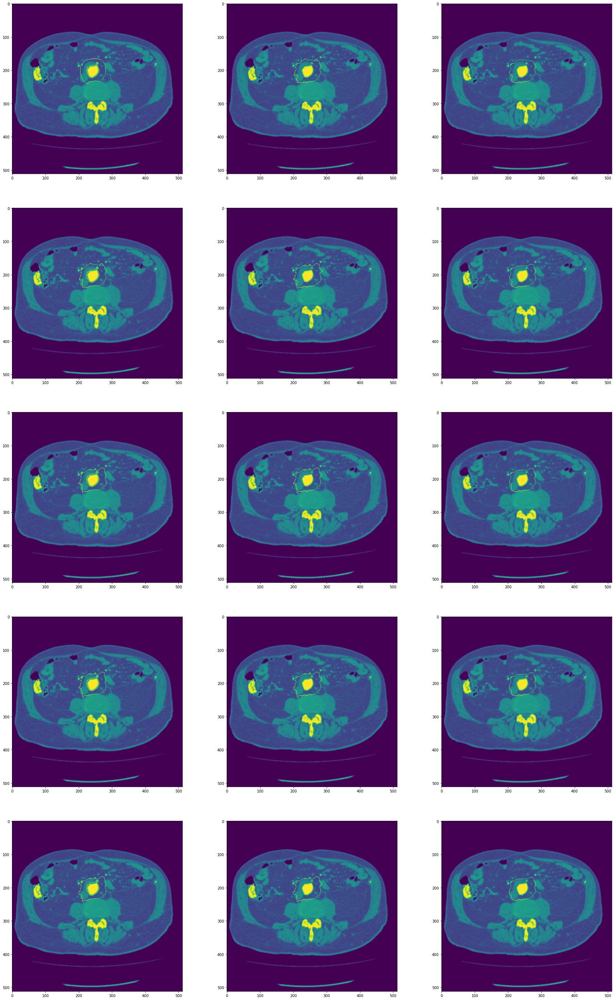

In [142]:
iters = 5
_, axes = plt.subplots(iters, 3, figsize=(30, iters*10))
orig = expanded
for i in range(iters):
    print(sum(sum(aorta)))
    _, _, _, _, cutted = gcpdf(picture, aorta, orig)
    cutted_contour, _ = cv2.findContours(cutted.astype("uint8"), 1, 1)
    canvas = picture.copy()
    cv2.drawContours(canvas, cutted_contour, -1, 250)
    axes[i][0].imshow(canvas)

    tuned = gcbac(picture, cutted, width=10)
    tuned_contour, _ = cv2.findContours(tuned.astype("uint8"), 1, 1)
    canvas = picture.copy()
    cv2.drawContours(canvas, tuned_contour, -1, 250)
    axes[i][1].imshow(canvas)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
    smoothed = cv2.dilate(cv2.erode(tuned.astype("uint8"), kernel), kernel)
    smoothed_contour, _ = cv2.findContours(smoothed.astype("uint8"), 1, 1)
    canvas = picture.copy()
    cv2.drawContours(canvas, smoothed_contour, -1, 250)
    axes[i][2].imshow(canvas)

    orig = smoothed
    orig = tuned